In [ ]:
!pip3 install scikit-learn
!pip3 install --upgrade ../.
!apt-get update
!apt-get install ffmpeg x264 libx264-dev libsm6 libxext6  -y
!pip install --upgrade opencv-python

In [19]:
from IPython.utils import io
import os
import subprocess
from tqdm.notebook import tqdm

import jax
import jax.numpy as jnp
import jax.lax as lax
from jax import jit
import haiku as hk

import sys
sys.path.append('/opt/conda/lib/python3.7/site-packages')

import os
os.environ['TF_FORCE_UNIFIED_MEMORY'] = '1'
os.environ['XLA_PYTHON_CLIENT_MEM_FRACTION'] = '2.0'

from urllib import request
from concurrent import futures
import json
from matplotlib import gridspec
from matplotlib.colors import hsv_to_rgb
import matplotlib.pyplot as plt
import numpy as np
#import py3Dmol

from functools import partial
import math
import sklearn
from sklearn.decomposition import PCA
import scipy

import alphafold

from alphafold.data import parsers
from alphafold.data import pipeline
from alphafold.data.tools import jackhmmer

from alphafold.common import protein

from alphafold.relax import relax
from alphafold.relax import utils

from IPython import display
from ipywidgets import GridspecLayout
from ipywidgets import Output

from enum import Enum

from numpy.polynomial import polynomial as P

import cv2
from scipy.ndimage.filters import gaussian_filter
from scipy.stats import zscore

In [2]:
## alphafold-inspect

class MODEL_NAMES(Enum):
    model_1 = 'model_1'
    model_2 = 'model_2'
    model_3 = 'model_3'
    model_4 = 'model_4'
    model_5 = 'model_5'
    model_1_ptm = 'model_1_ptm'
    model_2_ptm = 'model_2_ptm'
    model_3_ptm = 'model_3_ptm'
    model_4_ptm = 'model_4_ptm'
    model_5_ptm = 'model_5_ptm'
    
    
def load_model(folder, model_name):
    model_name = MODEL_NAMES[model_name].value
    from alphafold.model import config
    from alphafold.model import data
    config = config.model_config(model_name)
    params = data.get_model_haiku_params(model_name, folder)
    return config, params


class _LayerWrapper:
    layer_name = "layer/"
    param_basename = 'alphafold/'
    param_keys = []
    pca_param_key = 0
    base_model = None
    
    def __init__(self, config, params=None, batch_shape=(1,), rng_key=0):
        self.config = config
        self.batch_shape = tuple(batch_shape)
        self.rng_key = jax.random.PRNGKey(rng_key)
        
        self.param_basename += self.layer_name
        self.param_names = [self.param_basename + k for k in self.param_keys]
        self.layer_param_names = [self.layer_name + k for k in self.param_keys]
        
        self.params = self.init_params()
        if params is not None:
            self.load_params(params)
            
        self.pca = PCA().fit(self.params[self.layer_param_names[self.pca_param_key]]["weights"].T)
        self.components = jax.device_put(self.pca.components_)
        
    @property
    def from_pca(self):
        @jax.jit
        def _from_pca(x):
            n_components = x.shape[-1]
            return jnp.matmul(x, self.components[:n_components])
        return _from_pca
    
    @property
    def to_pca(self, n_components=3):
        @jax.jit
        def _to_pca(x):
            return jnp.matmul(x, self.components[:n_components].T)
        return _to_pca
      
    @property
    def random_key(self):
        return jax.random.split(self.rng_key)[1]
        
    @property
    def init_shape(self):
        return (0,)
        
    def init_params(self):
        init_tensor = jnp.zeros(self.init_shape)
        layer_params = hk.data_structures.to_mutable_dict(self.forward_init(self.random_key, init_tensor))
        return layer_params
    
    def load_params(self, params):
        for b, p in zip(self.layer_param_names, self.param_names):
            pdict = {}
            for k, v in params[p].items():
                if getattr(self, 'layer_id', False):
                    v = v[self.layer_id]
                pdict[k] = v
            self.params[b] = pdict
    
    @property
    def local_config(self):
        return self.config
    
    @property
    def global_config(self):
        return self.config.model.global_config
    
    @property
    def model(self):
        name = self.layer_name.replace('/', '')
        return self.base_model(self.local_config, self.global_config, name=name)

    @property
    def _forward(self):
        def _forward(x):
            return self.model(x)
        return _forward
    
    @property
    def forward_init(self):
        return hk.transform(self._forward).init
    
    @property
    def forward_apply(self):
        apply = hk.transform(self._forward).apply
        return partial(apply, self.params, self.random_key)
    
    @property
    def forward_residual(self):
        @jax.jit
        def _forward_residual(x):
            return x + self.forward_apply(x)
        return _forward_residual
    
    @property
    def jacobian(self):
        return jax.jacfwd(self.forward_apply)
    
class Linear(hk.Module):
    def __init__(self,
               num_output: int,
               initializer: str = 'linear',
               use_bias: bool = True,
               bias_init: float = 0.,
               name: str = 'linear'):
        super().__init__(name=name)
        self.num_output = num_output
        self.initializer = initializer
        self.use_bias = use_bias
        self.bias_init = bias_init

    def __call__(self, inputs: jnp.ndarray) -> jnp.ndarray:
        n_channels = int(inputs.shape[-1])

        weight_shape = [n_channels, self.num_output]
        if self.initializer == 'linear':
            weight_init = hk.initializers.VarianceScaling(mode='fan_in', scale=1.)
        elif self.initializer == 'relu':
            weight_init = hk.initializers.VarianceScaling(mode='fan_in', scale=2.)
        elif self.initializer == 'zeros':
            weight_init = hk.initializers.Constant(0.0)

        weights = hk.get_parameter('weights', weight_shape, inputs.dtype,
                                   weight_init)

        output = jnp.einsum('...c,cd->...d', inputs, weights)
        # this is equivalent to einsum('...c,cd->...d', inputs, weights)
        # but turns out to be slightly faster
        #inputs = jnp.swapaxes(inputs, -1, -2)
        #output = jnp.einsum('...cb,cd->...db', inputs, weights)
        #output = jnp.swapaxes(output, -1, -2)

        if self.use_bias:
            bias = hk.get_parameter('bias', [self.num_output], inputs.dtype,
                                  hk.initializers.Constant(self.bias_init))
            output += bias

        return output
    
class TransitionRunner(hk.Module):
    def __init__(self, config, global_config, name='transition_block'):
        super().__init__(name=name)
        self.config = config
        self.global_config = global_config

    def __call__(self, act):
        nc = act.shape[-1]
        num_intermediate = int(nc * self.config.num_intermediate_factor)

        return hk.Sequential([
            hk.LayerNorm(
                axis=[-1],
                create_scale=True,
                create_offset=True,
                name='input_layer_norm'),
            Linear(
                num_intermediate,
                initializer='relu',
                name='transition1'),
            jax.nn.relu,
            Linear(
                nc,
                initializer=alphafold.model.utils.final_init(self.global_config),
                name='transition2')
        ])(act)
    
class PairTransition(_LayerWrapper):
    layer_name = "pair_transition/"
    param_basename = "alphafold/alphafold_iteration/evoformer/evoformer_iteration/"
    param_keys = ['input_layer_norm', 'transition1', 'transition2']
    pca_param_key = 1
    base_model = TransitionRunner
    
    def __init__(self, layer_id, *args, **kwargs):
        self.layer_id = layer_id
        super(PairTransition, self).__init__(*args, **kwargs)
        
    @property
    def init_shape(self):
        c = self.config.model.embeddings_and_evoformer.pair_channel
        return (c,)
        
    @property
    def local_config(self):
        return self.config.model.embeddings_and_evoformer.evoformer.pair_transition
    
    
def from_spherical(angle_grid, r):
    return np.stack([
        r * np.cos(angle_grid[...,0]) * np.sin(angle_grid[...,1]),
        r * np.sin(angle_grid[...,0]) * np.sin(angle_grid[...,1]),
        r * np.cos(angle_grid[..., 1])
    ], axis=-1)

def to_spherical(xyz):
    return np.stack([
        np.atan2(xyz[...,1], xyz[...,0]),
        np.atan2(np.linalg.norm(xyz[...,:2], axis=-1), xyz[...,2]),
        np.linalg.norm(xyz, axis=-1)
    ], axis=-1)

def get_grid_ns(n: int = 300, dims: int = 2, sizes = (-1.0, 1.0)):
    if type(n) is int:
        n = [n] * dims
    if type(sizes[0]) in [float, int]:
        sizes = [sizes] * dims

    steps = [np.linspace(sizes[i][0], sizes[i][1], n[i]) for i in range(dims)]
    return np.stack(np.meshgrid(*steps), axis=-1)

In [3]:
layer_idx = 34
integrate = False

def loop(f, n):
    @jax.jit
    def step(i, x):
        return f(x)
    return partial(jax.lax.fori_loop, 1, n, step)

def loop_collect(forward_fn, out_fn, n, unroll=1):
    @jax.jit
    def step(x, _):
        y = forward_fn(x)
        return y, out_fn(y)
    return partial(jax.lax.scan, step, xs=None, length=n, unroll=unroll)

#runge-katta
def integrate(f, step_size=1):
    @jax.jit
    def _integrate(x):
        k1 = step_size * f(x)
        k2 = step_size * f(x + k1/2.)
        k3 = step_size * f(x + k2/2.)
        k4 = step_size * f(x + k3)
        
        return x + 1./6 * (k1 + 2 * k2 + 2 * k3 + k4)
    return _integrate

params_folder = '../alphafold/data'
model_name = 'model_2'

config, params = load_model(params_folder, model_name)
layer = PairTransition(layer_idx, config, params)

if integrate:
    forward_fn = integrate(layer.forward_residual, step_size=0.004)
else:
    forward_fn = layer.forward_residual
@jit
def pre_fn(x):
    proj = layer.from_pca(x)
    return proj#loop(layer.forward_residual, 256)(proj)
jac_fn = jit(layer.jacobian)

#cpu_fn = jit(jnp.linalg.eigvals, backend='cpu')
def cpu_fn(x, n):
    ys = []
    def step(x):
        y, x = np.linalg.eig(x)
        return x, y
    for i in range(n):
        x, y = step(x)
        ys.append(y)
    return np.stack(ys, axis=-1)

In [13]:
num_frames = 2570

from functools import partial
def cpu_fn(square_matrix):
    eigvals, eigvecs = jnp.linalg.eig(square_matrix)
    return eigvals, eigvecs
cpu_fn = jit(cpu_fn, backend='cpu')
    

point = jax.random.normal(layer.rng_key, (layer.init_shape[-1],))
point = pre_fn(point)

eigvals = np.zeros((num_frames, 128), dtype=np.complex64)
eigvecs = np.zeros((num_frames, 128, 128), dtype=np.complex64)
for frame_idx in tqdm(range(num_frames)):
    jac = jac_fn(point)
    #eigvals, eigvecs = cpu_fn(jac.astype(jnp.complex64))
    _eigvals, _eigvecs = cpu_fn(jac)
    eigvals[frame_idx] = _eigvals
    eigvecs[frame_idx] = _eigvecs
    point = forward_fn(point)

  0%|          | 0/2570 [00:00<?, ?it/s]

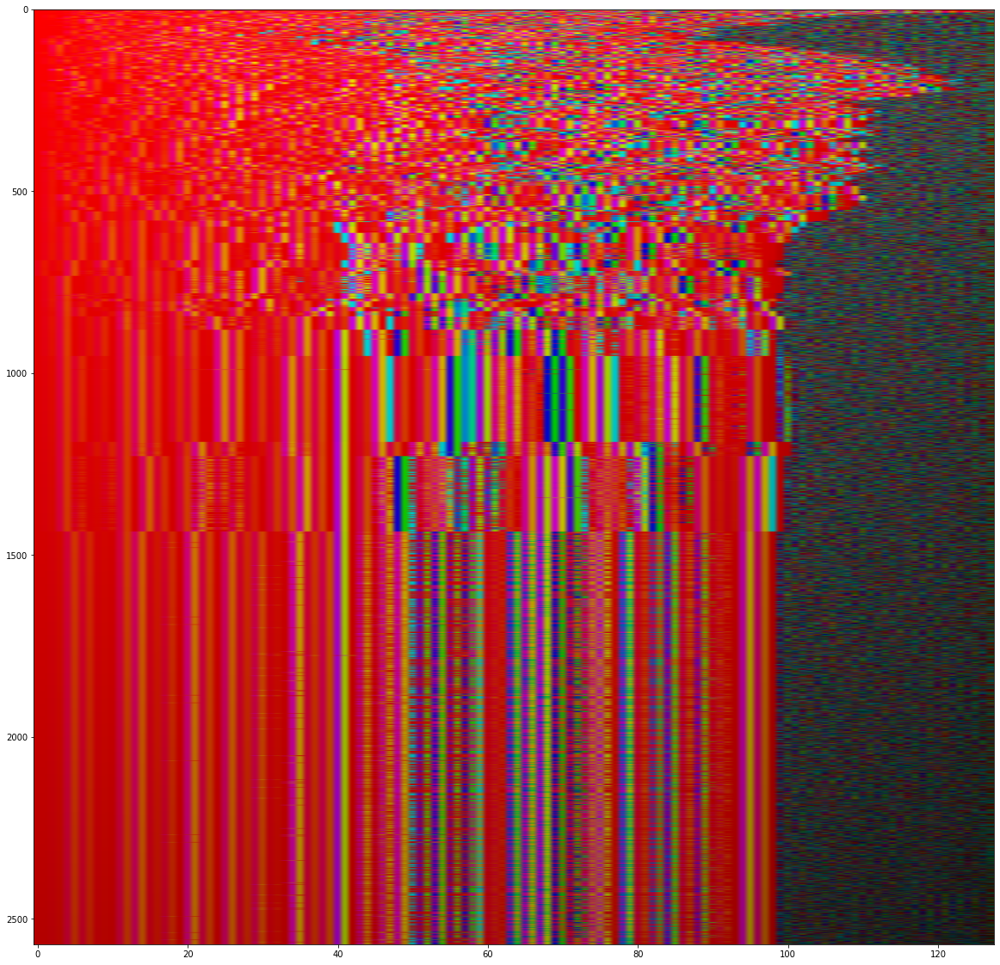

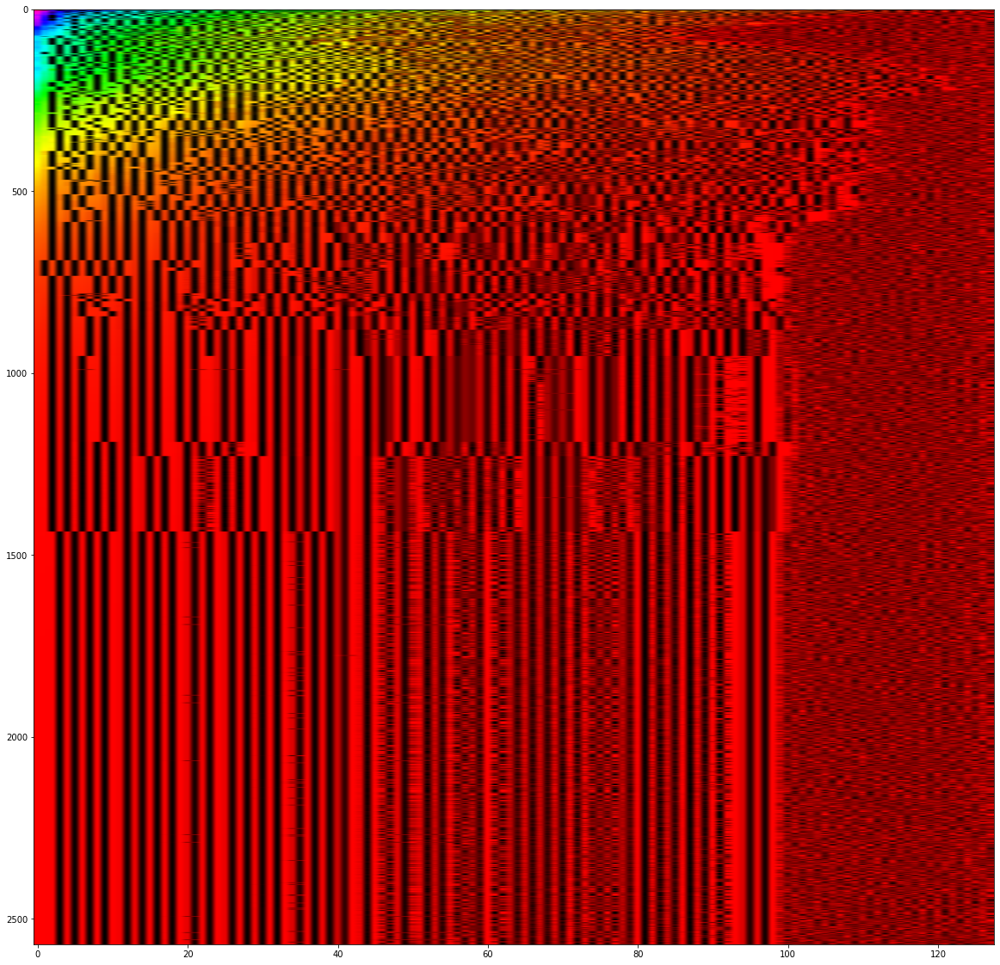

In [14]:
def norm01(array, eps=1e-9):
    array = array - array.min()
    return array / (array.max() + eps)

def domain_color(hue, value):
    saturation = np.ones_like(hue)
    hsv = np.stack([norm01(hue), saturation, norm01(value)], axis=-1)
    return hsv_to_rgb(hsv)

def float_to_pixel(image):
    return (image * 255.99).astype(np.uint8)

rgb = domain_color(np.angle(eigvals), np.log(np.abs(eigvals)))
plt.imshow(float_to_pixel(rgb), aspect='auto')
plt.gcf().set_size_inches(20, 20)
plt.show()

rgb = domain_color(np.abs(eigvals), np.angle(eigvals))
plt.imshow(float_to_pixel(rgb), aspect='auto')
plt.gcf().set_size_inches(20, 20)
plt.show()

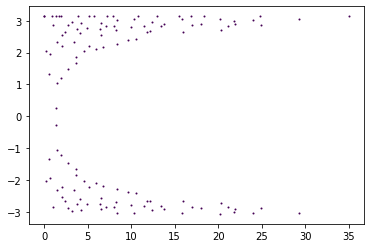

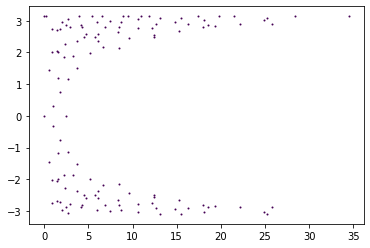

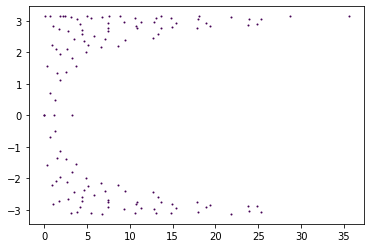

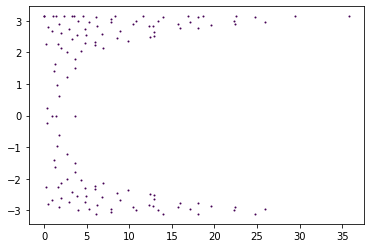

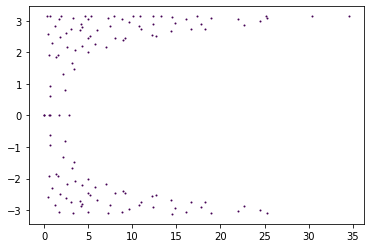

...

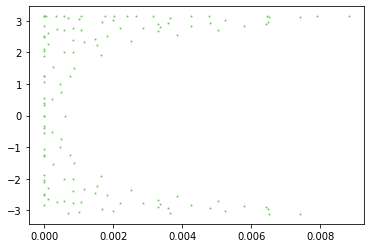

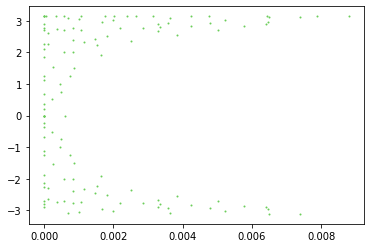

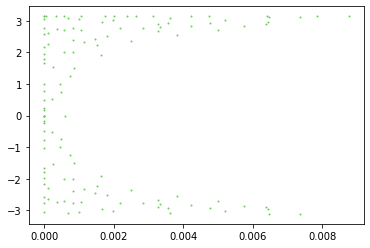

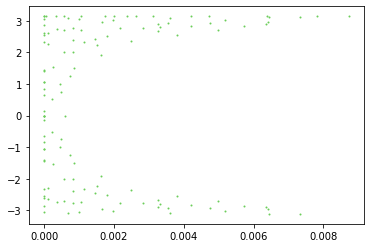

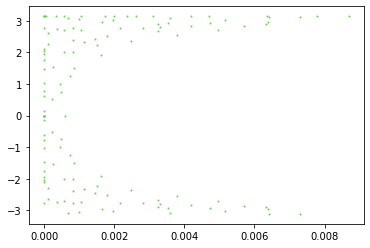

In [25]:
for i in range(eigvals.shape[0]):
    plt.scatter(
        np.abs(eigvals[i]), 
        np.angle(eigvals[i]),
        s=1,
        color=plt.cm.viridis(i / (eigvals.shape[0] - 1))
    )
    plt.show()

In [33]:
for i in range(eigvals.shape[-1]):
    hist, xedges, yedges = np.histogram2d(
        eigvals[:,i].real, 
        eigvals[:,i].imag,
        bins=100
    )
    plt.imshow(
        np.log(hist + 1e-9), 
        extent=[xedges[0], xedges[1], yedges[0], yedges[1]]
    )
    plt.show()

In [60]:
bins = 1000

angles = np.zeros((eigvals.shape[0], bins))
for i in range(eigvals.shape[0]):
    angles[i], xedges = np.histogram(
        np.angle(eigvals[i]),
        bins=bins
    )
plt.imshow(angles > 0, aspect='auto')
plt.axis('off')
plt.title("Angles")
plt.gcf().set_size_inches(15, 15)
plt.show()

mags = np.zeros((eigvals.shape[0], bins))
for i in range(eigvals.shape[0]):
    mags[i], xedges = np.histogram(
        np.abs(eigvals[i]),
        bins=bins
    )
plt.imshow(mags > 0, aspect='auto')
plt.axis('off')
plt.title("Magnitudes")
plt.gcf().set_size_inches(15, 15)
plt.show()

In [62]:
bins = 1000

angles = np.zeros((eigvals.shape[0], bins))
for i in range(eigvals.shape[0]):
    real_mask = np.isclose(eigvals[i].imag, 0)
    angles[i], xedges = np.histogram(
        np.angle(eigvals[i,real_mask]),
        bins=bins
    )
plt.imshow(angles > 0, aspect='auto')
plt.axis('off')
plt.title("Real Angles")
plt.gcf().set_size_inches(15, 15)
plt.show()

mags = np.zeros((eigvals.shape[0], bins))
for i in range(eigvals.shape[0]):
    real_mask = np.isclose(eigvals[i].imag, 0)
    mags[i], xedges = np.histogram(
        np.abs(eigvals[i,real_mask]),
        bins=bins
    )
plt.imshow(mags > 0, aspect='auto')
plt.axis('off')
plt.title("Real Magnitudes")
plt.gcf().set_size_inches(15, 15)
plt.show()

In [63]:
bins = 1000

angles = np.zeros((eigvals.shape[0], bins))
for i in range(eigvals.shape[0]):
    real_mask = np.isclose(eigvals[i].imag, 0)
    angles[i], xedges = np.histogram(
        np.angle(eigvals[i,~real_mask]),
        bins=bins
    )
plt.imshow(angles > 0, aspect='auto')
plt.axis('off')
plt.title("Imaginary Angles")
plt.gcf().set_size_inches(15, 15)
plt.show()

mags = np.zeros((eigvals.shape[0], bins))
for i in range(eigvals.shape[0]):
    real_mask = np.isclose(eigvals[i].imag, 0)
    mags[i], xedges = np.histogram(
        np.abs(eigvals[i,~real_mask]),
        bins=bins
    )
plt.imshow(mags > 0, aspect='auto')
plt.axis('off')
plt.title("Imaginary Magnitudes")
plt.gcf().set_size_inches(15, 15)
plt.show()

In [111]:
skip_iters = 0
interp_steps = 10000

from functools import partial
def cpu_fn(square_matrix):
    eigvals, eigvecs = jnp.linalg.eig(square_matrix)
    return eigvals, eigvecs
cpu_fn = jit(cpu_fn, backend='cpu')
    

point = jax.random.normal(layer.rng_key, (layer.init_shape[-1],))
point = pre_fn(point)

for i in tqdm(range(skip_iters), "skip iterations"):
    point = forward_fn(point)
    
out_point = forward_fn(point)
steps = np.linspace(point, out_point, interp_steps)
eigvals = np.zeros((interp_steps, 128), dtype=np.complex64)
eigvecs = np.zeros((interp_steps, 128, 128), dtype=np.complex64)
for i in tqdm(range(interp_steps), "interpolation"):
    jac = jac_fn(steps[i])
    eigvals[i], eigvecs[i] = cpu_fn(jac)

skip iterations: 0it [00:00, ?it/s]

interpolation:   0%|          | 0/10000 [00:00<?, ?it/s]

In [127]:
bins = 1000

hist_min = eigvals.real.min()
hist_max = eigvals.real.max()
hist = np.zeros((interp_steps, bins))
for i in tqdm(range(interp_steps)):
    real_mask = ~np.isclose(eigvals[i].imag, 0)
    hist[i], xedges = np.histogram(
        eigvals[i,real_mask].real,
        bins=bins,
        range=(hist_min, hist_max),
        density=True
    )
    
plt.imshow(
    hist.T[::-1] > 0, 
    aspect='auto',
    extent=[0, interp_steps, hist_min, hist_max]
)
plt.xlabel("Interpolation Steps")
plt.ylabel("Real Component")
plt.gcf().set_size_inches(16, 9)
plt.show()

  0%|          | 0/10000 [00:00<?, ?it/s]

In [163]:
skip_iters = 0
iters = 100
interp_steps = 10000
bins = 1000

@jax.jit
def det_fn(square_matrix):
    sign, logdet = jnp.linalg.slogdet(square_matrix)
    return sign * logdet
    

point = jax.random.normal(layer.rng_key, (layer.init_shape[-1],))
point = pre_fn(point)

for i in tqdm(range(skip_iters), "skip iterations"):
    point = forward_fn(point)
    
dets = np.zeros((interp_steps * iters,), dtype=np.complex64)
for i in tqdm(range(iters), "iteration"):
    out_point = forward_fn(point)
    steps = np.linspace(point, out_point, interp_steps)
    for j in tqdm(range(interp_steps), "interpolate", leave=False):
        jac = jac_fn(steps[j])
        dets[i * j + j] = det_fn(jac)
    point = out_point
    
print("All Real:", np.all(np.isclose(dets.imag, 0)))

magnitudes = np.abs(dets)
plt.scatter(np.arange(len(dets)), magnitudes, s=0.1)
plt.plot(gaussian_filter(magnitudes, sigma=250), color='red')
plt.gcf().set_size_inches(20, 10)
plt.show()

skip iterations: 0it [00:00, ?it/s]

iteration:   0%|          | 0/100 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

interpolate:   0%|          | 0/10000 [00:00<?, ?it/s]

All Real: True
